In [1]:
#from imports import *

In [100]:
import warnings
warnings.filterwarnings('ignore')

import geopandas as gpd
import pandas as pd
import numpy as np

#visualization imports/settings
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Scatter, Figure, Layout
import plotly.figure_factory as ff 
init_notebook_mode(connected = True) 

import matplotlib.pyplot as plt
import seaborn as sns
from yellowbrick.regressor import PredictionError, ResidualsPlot
import folium
from folium.features import GeoJsonTooltip
import branca.colormap as cm
import json

#from fbprophet import Prophet
#plt.style.use('fivethirtyeight')
#import pickle
#import gc
#import bokeh.palettes
from bokeh.palettes import Spectral4, Bokeh6
from bokeh.plotting import figure, output_notebook, show
from bokeh.util.warnings import BokehUserWarning 
import warnings 
warnings.simplefilter(action = 'ignore', category = BokehUserWarning)

#use this format specifier exactly AS IS to avoid breaking module, space matters!
#pd.options.display.float_format = '{:20,.2f}'.format 
sns.set_style("white")



from sklearn.linear_model import LinearRegression, LassoLars, TweedieRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

import new4
from env import get_db_url

#imports for statistics tests
import scipy.stats as stats
from scipy.stats import pearsonr, spearmanr


#sklearn imports
from sklearn.decomposition import PCA #Principal Component Analysis
from sklearn.manifold import TSNE #T-Distributed Stochastic Neighbor Embedding
from sklearn.linear_model import LinearRegression, LassoLars, TweedieRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.cluster import KMeans

In [3]:
#acquire data
train, validate, test, df = new4.wrangled_zillow()

#acquire split data
train_VC, train_LA, train_OC, validate_VC, validate_LA, validate_OC, test_VC, test_LA, test_OC = new4.split_county_tvt(train, validate, test) 

#acquire scaled data
scaler, train_scaled, validate_scaled, test_scaled = new4.scale_data(train, validate, test, return_scaler = True)

#acquire scaled split data
scaler, train_scaled_VC, train_scaled_LA, train_scaled_OC, validate_scaled_VC, validate_scaled_LA, validate_scaled_OC, test_scaled_VC, test_scaled_LA, test_scaled_OC = new4.scale_split_data(train, validate, test, return_scaler = True)

train.head()

Acquiring from SQL database


,propertylandusetypeid,bathrooms,bedrooms,area,county,latitude,longitude,lot_size,census_tract,region_id_city,...,lot_dollar_sqft_bin,bath_bed_ratio,cola,logerror_bins,bed_and_bath,tax_value_binned,tax_value_encoded,pw_build,pw_build_encoded,abs_logerror
48107,261.0,2.0,4.0,1461.0,LA,34.102910,-117.886037,7067.0,60.374059,24245,...,0.3,0.500000,0,"(0.05, 0.2]",6.0,Med,1,True,1,0.060393
67544,261.0,2.0,3.0,1096.0,OC,33.854496,-117.981598,2980.0,60.590868,16764,...,0.3,0.666667,0,"(-0.05, 0.05]",5.0,Med,1,True,1,0.040962
53781,261.0,2.0,3.0,1554.0,LA,33.913990,-118.320611,5300.0,60.376026,45398,...,0.3,0.666667,0,"(-0.05, 0.05]",5.0,Low,0,True,1,0.031277
60586,261.0,2.0,3.0,1451.0,LA,34.686089,-118.189622,5868.0,60.379010,5534,...,0.2,0.666667,0,"(-0.05, 0.05]",5.0,Med,1,True,1,0.021057
31011,261.0,2.0,3.0,1702.0,LA,34.022588,-117.815344,7498.0,60.374033,24384,...,0.3,0.666667,0,"(-0.05, 0.05]",5.0,High,2,True,1,0.010155


In [4]:
train.groupby('county')['tax_value'].mean()

county
LA    128379.482363
OC    137771.964188
VC    184979.705721
Name: tax_value, dtype: float64

In [5]:
train.groupby('county')['logerror'].mean()

county
LA    0.003011
OC    0.006388
VC    0.005707
Name: logerror, dtype: float64

In [6]:
train.groupby('county')['abs_logerror'].mean()

county
LA    0.035653
OC    0.030384
VC    0.031101
Name: abs_logerror, dtype: float64

In [7]:
train.tax_value.mean()

136410.71040316776

In [8]:
train.logerror.mean()

0.004163035221261488

In [9]:
train[train.county == 'OC'].logerror.mean()

0.006388331317137385

In [10]:
train[train.county == 'VC'].logerror.mean()

0.00570674872789853

In [11]:
train[train.county == 'LA'].logerror.mean()

0.003011177020350781

In [12]:
train.abs_logerror.mean()

0.03382196151957899

In [13]:
train[train.county == 'OC'].abs_logerror.mean()
#when looking at absolute log error, OC has the lowest abs_log, 
#as homes get more expensive, are they more accurately zestimated?

0.03038392691673765

In [14]:
train[train.county == 'VC'].abs_logerror.mean()

0.03110093285664954

In [15]:
train[train.county == 'LA'].abs_logerror.mean()

0.03565325192095082

In [16]:
train.columns

Index(['propertylandusetypeid', 'bathrooms', 'bedrooms', 'area', 'county',
       'latitude', 'longitude', 'lot_size', 'census_tract', 'region_id_city',
       'region_id_county', 'zip_code', 'room_count', 'unit_count',
       'year_built', 'tax_value', 'total_tax', 'assessment_year', 'land_value',
       'tax_amount', 'transaction_date', 'logerror', 'property_desc', 'LA',
       'Orange', 'Ventura', 'age', 'age_bin', 'tax_rate', 'acres', 'acres_bin',
       'sqft_bin', 'structure_dollar_per_sqft', 'structure_dollar_sqft_bin',
       'land_dollar_per_sqft', 'lot_dollar_sqft_bin', 'bath_bed_ratio', 'cola',
       'logerror_bins', 'bed_and_bath', 'tax_value_binned',
       'tax_value_encoded', 'pw_build', 'pw_build_encoded', 'abs_logerror'],
      dtype='object')

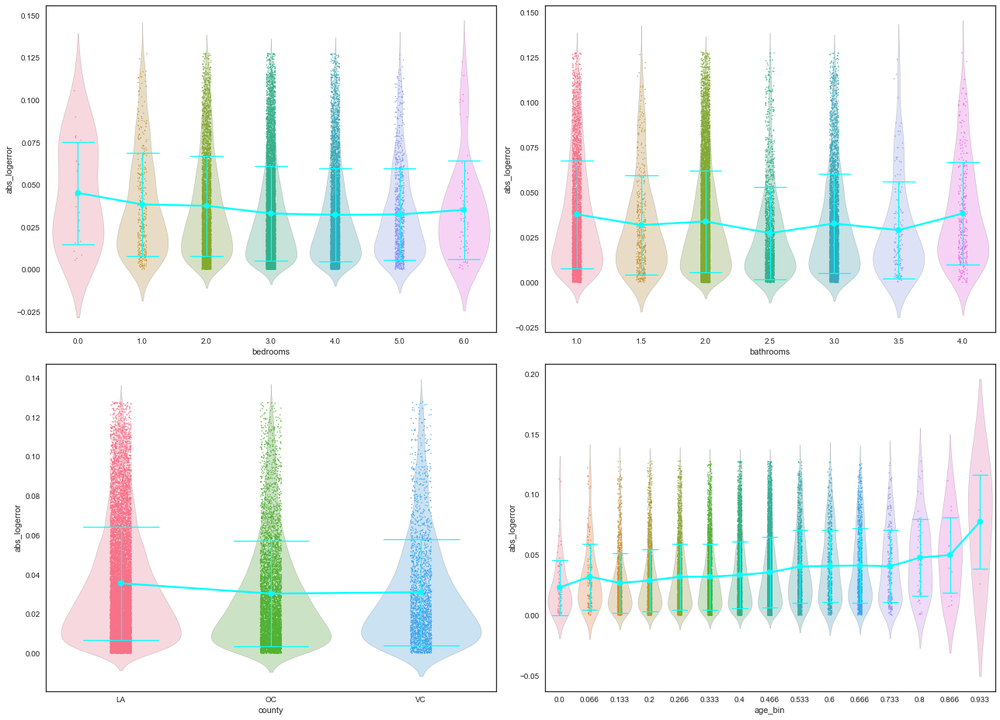

Loading BokehJS ...

Loading BokehJS ...

- Homes between 20 and 60 years old have the least absolute log error.
- The absolute log error varies significantly for homes older than 60 years old.

Loading BokehJS ...

Loading BokehJS ...

Loading BokehJS ...

In [23]:
X = train[['longitude', 'latitude']]

In [24]:
#get baseline, baseline is mean of dependent variable yhat_baseline == baseline

baseline = train.abs_logerror.mean()

print(f' Absolute Log Error Baseline is: {baseline:.5f}')

 Absolute Log Error Baseline is: 0.03382


In [25]:
#get baseline, baseline is mean of dependent variable yhat_baseline == baseline

baseline = train.logerror.mean()

print(f' Baseline is: {baseline:.5f}')

 Baseline is: 0.00416


In [26]:
train.columns

Index(['propertylandusetypeid', 'bathrooms', 'bedrooms', 'area', 'county',
       'latitude', 'longitude', 'lot_size', 'census_tract', 'region_id_city',
       'region_id_county', 'zip_code', 'room_count', 'unit_count',
       'year_built', 'tax_value', 'total_tax', 'assessment_year', 'land_value',
       'tax_amount', 'transaction_date', 'logerror', 'property_desc', 'LA',
       'Orange', 'Ventura', 'age', 'age_bin', 'tax_rate', 'acres', 'acres_bin',
       'sqft_bin', 'structure_dollar_per_sqft', 'structure_dollar_sqft_bin',
       'land_dollar_per_sqft', 'lot_dollar_sqft_bin', 'bath_bed_ratio', 'cola',
       'logerror_bins', 'bed_and_bath', 'tax_value_binned',
       'tax_value_encoded', 'pw_build', 'pw_build_encoded', 'abs_logerror'],
      dtype='object')

In [27]:
#Read the geoJSON file using geopandas
geojson = gpd.read_file('georef-usa-county.geojson')

#select 'coty_code' (country fips) and 'geometry' columns
geojson = geojson[['coty_code','geometry']] 

#create variable based on fips with leading 0 as strings
geojson = geojson.loc[geojson['coty_code'].isin(['06037', '06059', '06111'])]
geojson.head()

,coty_code,geometry
331,06059,"POLYGON ((-118.14781 33.69408, -118.12590 33.6..."
563,06111,"MULTIPOLYGON (((-119.50095 34.32692, -119.4842..."
1402,06037,"MULTIPOLYGON (((-118.95172 33.99286, -118.9404..."


In [28]:
train.shape

(22224, 45)

In [29]:
#create new df from train
geo_df = train.copy()

#map fips to county abbreviations as a string
geo_df['fips'] = geo_df.county.map({'LA' : 6037,  'OC' : 6059, 'VC': 6111}).astype(str)

#add leading zeros to fips column
geo_df['fips'] = geo_df['fips'].str.zfill(5)

#join the geojson file to geo_df
geo_df = geojson.merge(geo_df, left_on = 'coty_code', right_on = 'fips', how = 'outer')

geo_df.head()

,coty_code,geometry,propertylandusetypeid,bathrooms,bedrooms,area,county,latitude,longitude,lot_size,...,bath_bed_ratio,cola,logerror_bins,bed_and_bath,tax_value_binned,tax_value_encoded,pw_build,pw_build_encoded,abs_logerror,fips
0,06059,"POLYGON ((-118.14781 33.69408, -118.12590 33.6...",261.0,2.0,3.0,1096.0,OC,33.854496,-117.981598,2980.0,...,0.666667,0,"(-0.05, 0.05]",5.0,Med,1,True,1,0.040962,06059
1,06059,"POLYGON ((-118.14781 33.69408, -118.12590 33.6...",261.0,3.0,4.0,2482.0,OC,33.878708,-117.912711,11528.0,...,0.750000,0,"(-0.05, 0.05]",7.0,Low,0,True,1,0.044798,06059
2,06059,"POLYGON ((-118.14781 33.69408, -118.12590 33.6...",261.0,2.0,5.0,2187.0,OC,33.778538,-117.809720,7200.0,...,0.400000,0,"(-0.05, 0.05]",7.0,Med,1,True,1,0.028641,06059
3,06059,"POLYGON ((-118.14781 33.69408, -118.12590 33.6...",261.0,2.0,3.0,1199.0,OC,33.925133,-117.970299,5510.0,...,0.666667,0,"(-0.05, 0.05]",5.0,Low,0,True,1,0.032503,06059
4,06059,"POLYGON ((-118.14781 33.69408, -118.12590 33.6...",261.0,1.0,2.0,1085.0,OC,33.744343,-117.930695,8645.0,...,0.500000,0,"(-0.05, 0.05]",3.0,Low,0,True,1,0.004013,06059


In [30]:
#cm.linear

In [31]:
geo_df.abs_logerror.min()

2.79594564056e-06

In [33]:
train.region_id_city.mode()

0    12447
dtype: int64

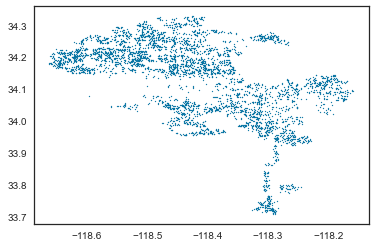

In [34]:
train.region_id_city.mode()


t = train[train.region_id_city == 12447]
plt.scatter(t.longitude, t.latitude,  s = 1)


# Stats

### Is the log error of Orange County significantly higher than the mean log error of Ventura, LA, and Orange counties?

One Sample T-Test

$\alpha$ = .05

$𝐻_{0}$: Orange County mean log error is <= than the combined mean log errors of Ventura, Los Angeles, and Orange counties.

𝐻𝑎: Orange County mean log error is > than the combined mean log errors of Ventura, Los Angeles, and Orange counties.

In [35]:
#set alpha
α = 0.05

#get sample
oc_sample = train[train.county == 'OC'].logerror

#get mean
overall_mean = train.logerror.mean()

#perform test
t, p = stats.ttest_1samp(oc_sample, overall_mean)

#print p-value
print(f'P Value: {p/2:.3f}')

#evaluate if mean of OC homes is significantly higher than all homes, is p/2 < a and t > 0?
if p/2 < α and t > 0:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

P Value: 0.000
Reject the null hypothesis.


### Is there a linear relationship between log error and home value?

Spearmans's R

$\alpha$ = .05

$𝐻_{0}$: There is no linear relationship between log error and home value.

𝐻𝑎: There is a linear relationship between log error and home value.

In [36]:
#tax_value not normally distributed, so use Spearman's
#set alpha
α = .05

#perform test
r, p = spearmanr(train.tax_value, train.logerror)

#evaluate coefficient and p-value
print(f'Correlation Coefficient: {r:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Correlation Coefficient: 0.015
P-value: 0.022
Reject the null hypothesis.


### Is there a linear relationship between log error and area?

Spearmans's R

$\alpha$ = .05

$𝐻_{0}$: There is no linear relationship between log error and area.

𝐻𝑎: There is a linear relationship between log error and area.

In [37]:
#area not normally distributed, so use Spearman's
#set alpha
α = .05

#perform test
r, p = spearmanr(train.area, train.logerror)

#evaluate coefficient and p-value
print(f'Correlation Coefficient: {r:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Correlation Coefficient: 0.064
P-value: 0.000
Reject the null hypothesis.


### Is the log error in LA significantly lower than the log error in Orange County?

Two Sample T-Test

$\alpha$ = .05

$𝐻_{0}$: LA County mean log error is >= than the mean log error of Orange County.

𝐻𝑎: LA County mean log error is < than the mean log error of Orange County.

In [38]:
#test for equal variance 
#H0 is that the variances are equal
# if p > .05, variances are not significantly different and set argument to equal_var = True
#if p < .05, variances are significantly different and set argument to equal_var = False
#Levene test on two groups


s, p = stats.levene(train[train.LA == 1].logerror,
             train[train.Orange == 1].logerror)
#print(p < .05)

In [39]:
#set alpha
α = 0.05

#perform test
t, p = stats.ttest_ind(train[train.LA == 1].logerror, train[train.Orange == 1].logerror, equal_var = False)

#print p-value
print(f'P Value: {p/2:.3f}')

#evaluate if mean of LA log error is significantly less than log error of Orange Co, is p/2 < a and t < 0?
if p/2 < α and t < 0:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

P Value: 0.000
Reject the null hypothesis.


### Is there a linear relationship between log error and the year built?

Spearmans's R

$\alpha$ = .05

$𝐻_{0}$: There is no linear relationship between log error and year built.

𝐻𝑎: There is a linear relationship between log error and year built.

In [40]:
#year_built not normally distributed, so use Spearman's
#set alpha
α = .05

#perform test
r, p = spearmanr(train.year_built, train.logerror)

#evaluate coefficient and p-value
print(f'Correlation Coefficient: {r:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')

Correlation Coefficient: 0.035
P-value: 0.000
Reject the null hypothesis.


# Clustering Exploration

In [41]:
#num_cols = ['bedrooms', 'bathrooms', 'area', 'latitude', 'longitude', 'lot_size', 'census_tract', 
#            'zip_code', 'room_count', 'unit_count', 'year_built', 'tax_value', 'tax_rate', 'assessment_year',
#            'tax_amount', 'bed_and_bath', 'tax_value_encoded', 'LA', 'Orange', 'Ventura']

area_cols = ['area', 'bathrooms', 'bedrooms', 'year_built', 'lot_size']


#create X variable
X_1 = train_scaled[area_cols]

#create kmeans variable
kmeans = KMeans(n_clusters = 5, random_state = 123)

#fit
kmeans.fit(X_1)

#make predictions
kmeans.predict(X_1)

#make predictions and assign to new column
train['area_clusters'] = kmeans.predict(X_1)


<AxesSubplot:xlabel='area', ylabel='logerror'>

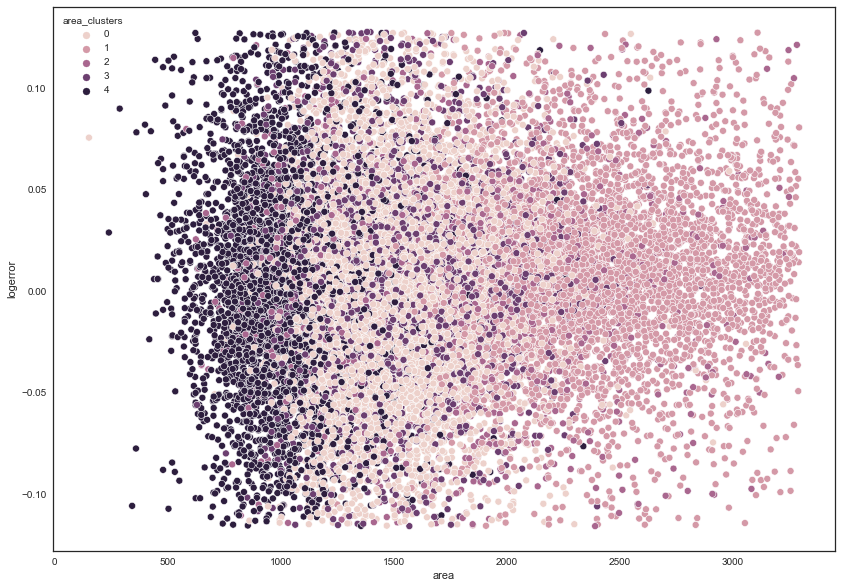

In [42]:
plt.figure(figsize = (14, 10))
sns.scatterplot(data = train,
            x = 'area',
            y = 'logerror',
            hue = 'area_clusters')

In [43]:
#num_cols = ['bedrooms', 'bathrooms', 'area', 'latitude', 'longitude', 'lot_size', 'census_tract', 
#            'zip_code', 'room_count', 'unit_count', 'year_built', 'tax_value', 'tax_rate', 'assessment_year',
#            'tax_amount', 'bed_and_bath', 'tax_value_encoded', 'LA', 'Orange', 'Ventura']

loc_cols = ['latitude', 'longitude', 'zip_code', 'region_id_county']


#create X variable on train-scaled
X_2 = train_scaled[loc_cols]

#create kmeans variable
kmeans = KMeans(n_clusters = 3, random_state = 123)

#fit
kmeans.fit(X_2)

#make predictions
kmeans.predict(X_2)

#make predictions and assign to new column on train
train['location_clusters'] = kmeans.predict(X_2)


<AxesSubplot:xlabel='longitude', ylabel='latitude'>

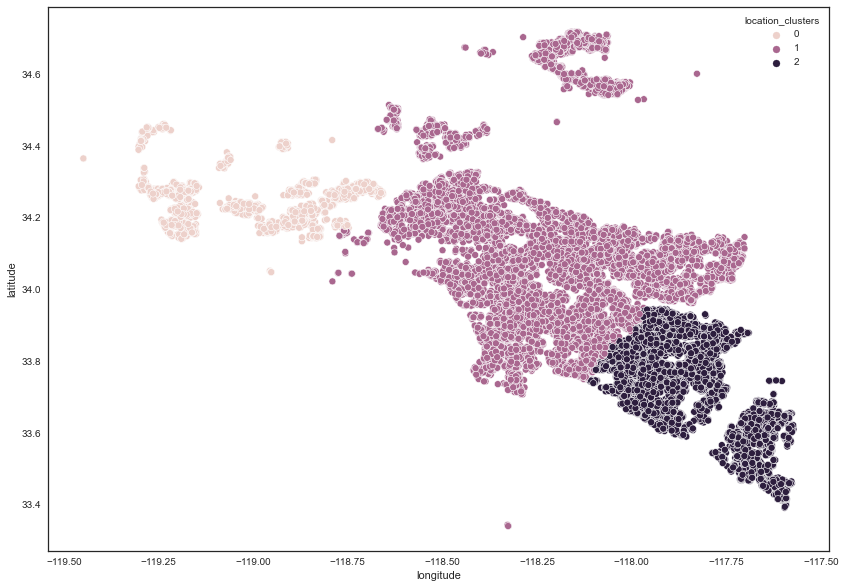

In [44]:
plt.figure(figsize = (14, 10))

sns.despine(left = True, bottom = True)

sns.scatterplot(data = train,
            x = 'longitude',
            y = 'latitude',
            hue = 'location_clusters')

In [45]:
#num_cols = ['bedrooms', 'bathrooms', 'area', 'latitude', 'longitude', 'lot_size', 'census_tract', 
#            'zip_code', 'room_count', 'unit_count', 'year_built', 'tax_value', 'tax_rate', 'assessment_year',
#            'tax_amount', 'bed_and_bath', 'tax_value_encoded', 'LA', 'Orange', 'Ventura']

val_cols = ['tax_amount']


#create X variable
X_3 = train_scaled[val_cols]

#create kmeans variable
kmeans = KMeans(n_clusters = 3, random_state = 123)

#fit
kmeans.fit(X_3)

#make predictions
kmeans.predict(X_3)

#make predictions and assign to new column
train['value_clusters'] = kmeans.predict(X_3)


<AxesSubplot:xlabel='tax_amount', ylabel='logerror'>

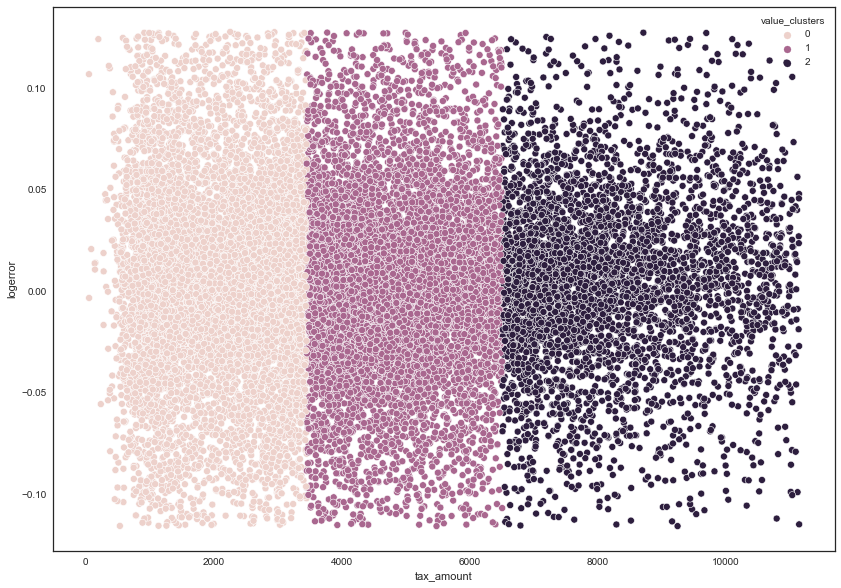

In [46]:
plt.figure(figsize = (14, 10))

sns.despine(left = True, bottom = True)

sns.scatterplot(data = train,
            x = 'tax_amount',
            y = 'logerror',
            hue = 'value_clusters',
            sizes = (30, 150))

In [47]:
#num_cols = ['bedrooms', 'bathrooms', 'area', 'latitude', 'longitude', 'lot_size', 'census_tract', 
#            'zip_code', 'room_count', 'unit_count', 'year_built', 'tax_value', 'tax_rate', 'assessment_year',
#            'tax_amount', 'bed_and_bath', 'tax_value_encoded', 'LA', 'Orange', 'Ventura']




#create X variable
X_4 = train_scaled[['area']]

#create kmeans variable
kmeans = KMeans(n_clusters = 5, random_state = 123)

#fit
kmeans.fit(X_4)

#make predictions
kmeans.predict(X_4)

#make predictions and assign to new column
train['area_1_clusters'] = kmeans.predict(X_4)


<AxesSubplot:xlabel='area', ylabel='logerror'>

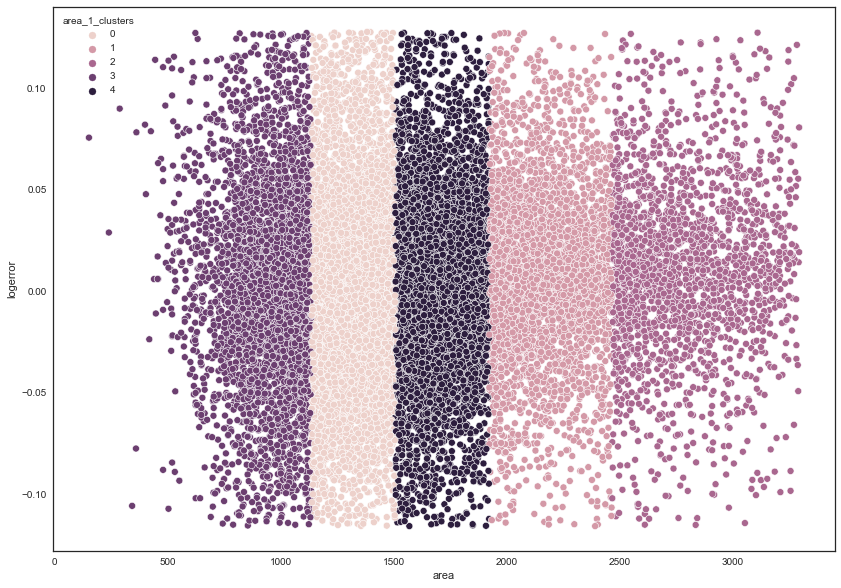

In [48]:
plt.figure(figsize = (14, 10))

sns.despine(left = True, bottom = True)

sns.scatterplot(data = train,
            x = 'area',
            y = 'logerror',
            hue = 'area_1_clusters')

In [49]:
#create X variable
X_5 = train_scaled[['tax_amount']]

#create kmeans variable
kmeans = KMeans(n_clusters = 5, random_state = 123)

#fit
kmeans.fit(X_5)

#make predictions
kmeans.predict(X_5)

#make predictions and assign to new column
train['tax_clusters'] = kmeans.predict(X_5)

<AxesSubplot:xlabel='tax_amount', ylabel='logerror'>

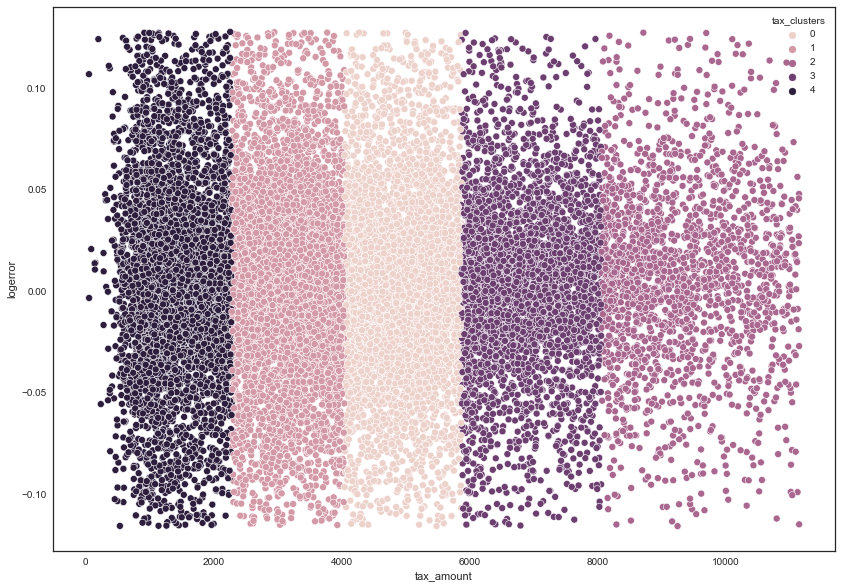

In [50]:
plt.figure(figsize = (14, 10))

sns.despine(left = True, bottom = True)

sns.scatterplot(data = train,
            x = 'tax_amount',
            y = 'logerror',
            hue = 'tax_clusters')

In [51]:
#create X variable
X_6 = train_scaled[['area', 'age']]

#create kmeans variable
kmeans = KMeans(n_clusters = 5, random_state = 123)

#fit
kmeans.fit(X_6)

#make predictions
kmeans.predict(X_6)

#make predictions and assign to new column
train['age_area_clusters'] = kmeans.predict(X_6)

<AxesSubplot:xlabel='area', ylabel='logerror'>

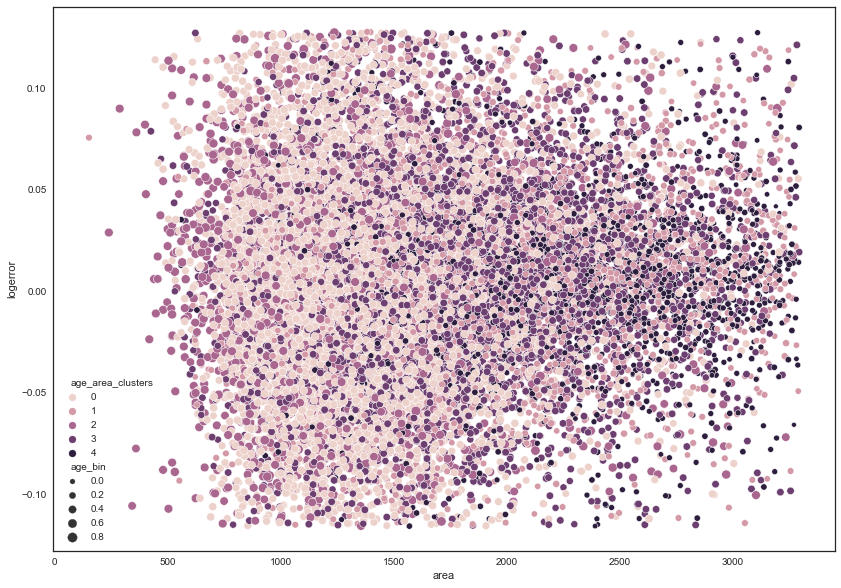

In [52]:
plt.figure(figsize = (14, 10))

sns.despine(left = True, bottom = True)

sns.scatterplot(data = train,
            x = 'area',
            y = 'logerror',
            hue = 'age_area_clusters',
            size = 'age_bin')

In [53]:
train.groupby('county')['tax_value'].mean()

county
LA    128379.482363
OC    137771.964188
VC    184979.705721
Name: tax_value, dtype: float64

# Transformations

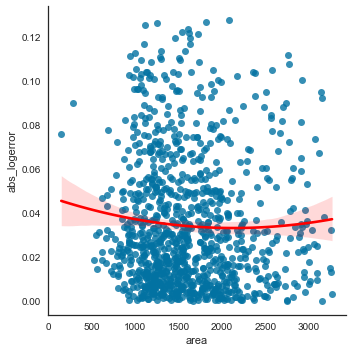

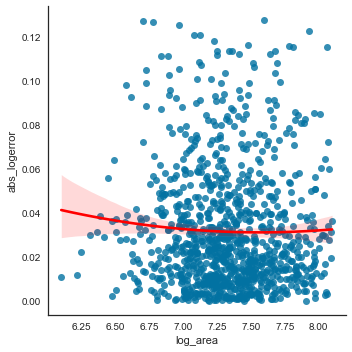

In [54]:
#log transformation
train['log_area'] = np.log(train['area'])

sns.lmplot(data = train.sample(1000), x = 'area', y = 'abs_logerror', order = 2, line_kws = {'color': 'red'})
sns.lmplot(x = 'log_area', y = 'abs_logerror', data = train.sample(1000), order = 2, line_kws = {'color': 'red'})

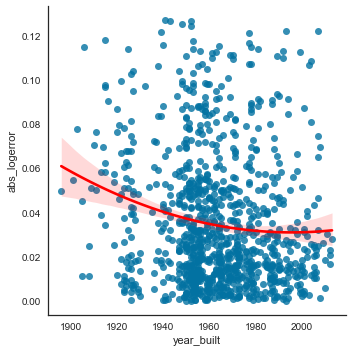

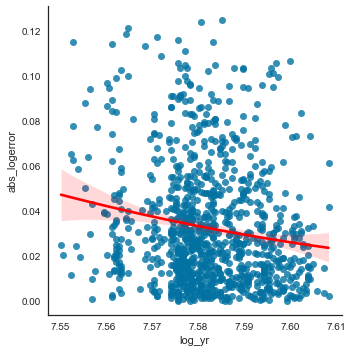

In [55]:
#log transformation
train['log_yr'] = np.log(train['year_built'])

sns.lmplot(data = train.sample(1000), x = 'year_built', y = 'abs_logerror', order = 2, line_kws = {'color': 'red'})
sns.lmplot(x = 'log_yr', y = 'abs_logerror', data = train.sample(1000), order = 2, line_kws = {'color': 'red'})

((array([-4.00363233, -3.78874472, -3.67121335, ...,  3.67121335,
          3.78874472,  4.00363233]),
  array([7.53796266, 7.54009032, 7.5416831 , ..., 7.60837447, 7.60837447,
         7.60837447])),
 (0.010664744843627897, 7.582495980349233, 0.9932106116650684))

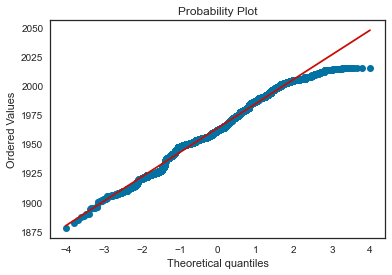

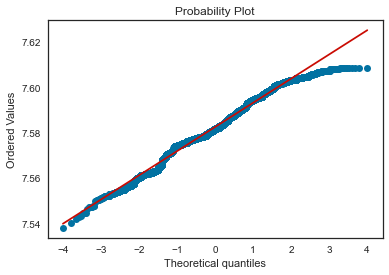

In [56]:
plt.figure()
stats.probplot(train['year_built'], dist = 'norm', plot = plt)
plt.figure()
stats.probplot(train['log_yr'], dist = 'norm', plot = plt)

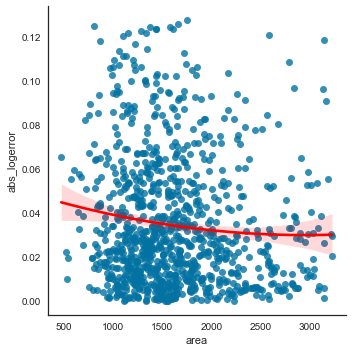

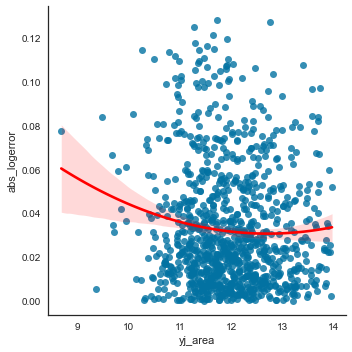

In [57]:
#yeo-johnson transformation

from sklearn.preprocessing import PowerTransformer

transformer = PowerTransformer(method = 'yeo-johnson', standardize = False)
train['yj_area'] = transformer.fit_transform(train[['area']])


sns.lmplot(data = train.sample(1000), x = 'area', y = 'abs_logerror', order = 2, line_kws = {'color': 'red'})
sns.lmplot(x = 'yj_area', y = 'abs_logerror', data = train.sample(1000), order = 2, line_kws = {'color': 'red'})

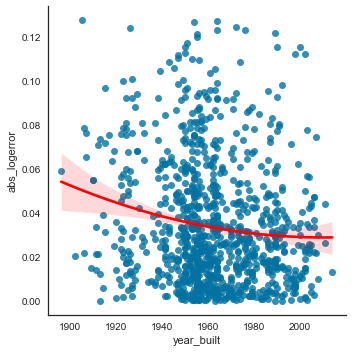

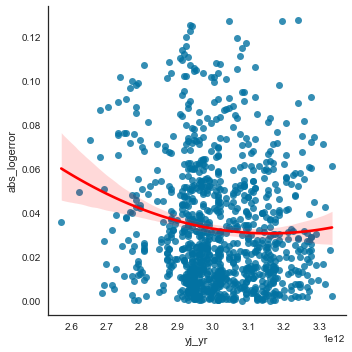

In [58]:
transformer = PowerTransformer(method = 'yeo-johnson', standardize = False)
train['yj_yr'] = transformer.fit_transform(train[['year_built']])


sns.lmplot(data = train.sample(1000), x = 'year_built', y = 'abs_logerror', order = 2, line_kws = {'color': 'red'})
sns.lmplot(x = 'yj_yr', y = 'abs_logerror', data = train.sample(1000), order = 2, line_kws = {'color': 'red'})

((array([-4.00363233, -3.78874472, -3.67121335, ...,  3.67121335,
          3.78874472,  4.00363233]),
  array([ 6.99147372,  7.86550791,  8.22896159, ..., 13.98038885,
         13.98205161, 13.98205161])),
 (0.8538330791160585, 11.995380938031287, 0.9974641392661295))

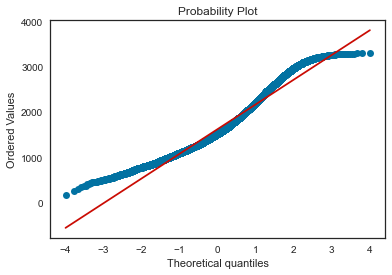

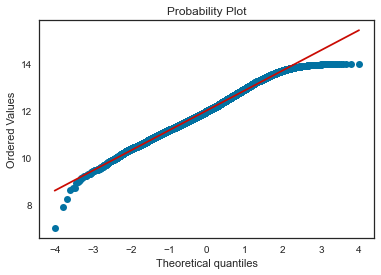

In [59]:
plt.figure()
stats.probplot(train['area'], dist = 'norm', plot = plt)
plt.figure()
stats.probplot(train['yj_area'], dist = 'norm', plot = plt)

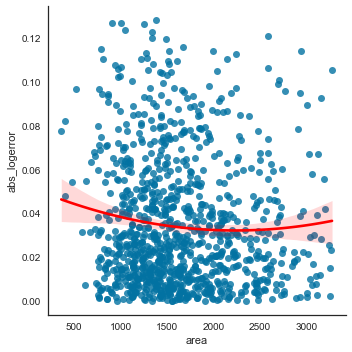

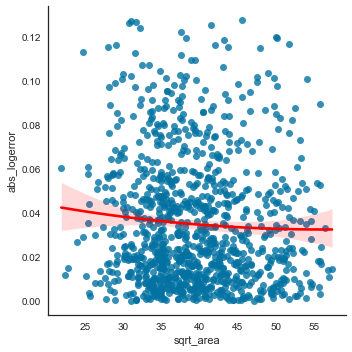

In [60]:
#sqrt transformation
train['sqrt_area'] = np.sqrt(train['area'])

sns.lmplot(data = train.sample(1000), x = 'area', y = 'abs_logerror', order = 2, line_kws = {'color': 'red'})
sns.lmplot(x = 'sqrt_area', y = 'abs_logerror', data = train.sample(1000), order = 2, line_kws = {'color': 'red'})

((array([-4.00363233, -3.78874472, -3.67121335, ...,  3.67121335,
          3.78874472,  4.00363233]),
  array([12.32882801, 15.49193338, 16.97056275, ..., 57.38466694,
         57.40209055, 57.40209055])),
 (6.75842430621426, 39.68273516703676, 0.9936149508093705))

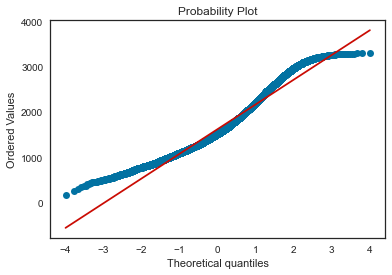

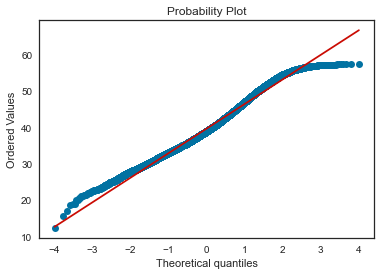

In [61]:
plt.figure()
stats.probplot(train['area'], dist = 'norm', plot = plt)
plt.figure()
stats.probplot(train['sqrt_area'], dist = 'norm', plot = plt)

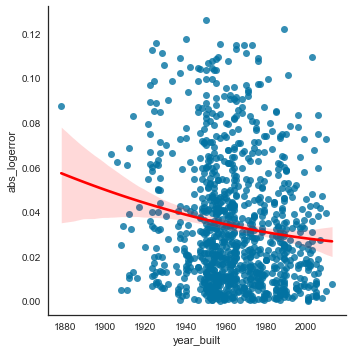

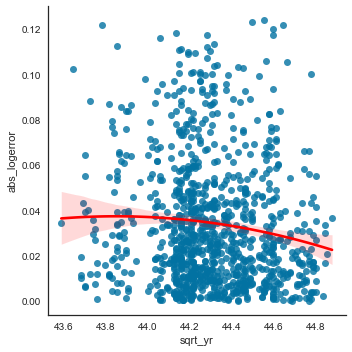

In [62]:
#sqrt transformation
train['sqrt_yr'] = np.sqrt(train['year_built'])

sns.lmplot(data = train.sample(1000), x = 'year_built', y = 'abs_logerror', order = 2, line_kws = {'color': 'red'})
sns.lmplot(x = 'sqrt_yr', y = 'abs_logerror', data = train.sample(1000), order = 2, line_kws = {'color': 'red'})

Text(0.5, 1.0, 'Square Root Transformed Data')

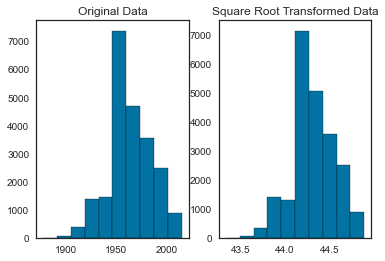

In [63]:
#define grid of plots
fig, axs = plt.subplots(nrows = 1, ncols = 2)

#create histograms
axs[0].hist(train['year_built'], edgecolor = 'black')
axs[1].hist(train['sqrt_yr'], edgecolor='black')

#add title to each histogram
axs[0].set_title('Original Data')
axs[1].set_title('Square Root Transformed Data')

In [64]:
from sklearn.preprocessing import MinMaxScaler

def create_clusters(train, X, k):
    scaler = MinMaxScaler(copy = True, feature_range = (0,1)).fit(X)
    X_scaled = pd.DataFrame(scaler.transform(X), columns = X.columns.values).set_index([X.index.values])
    kmeans = KMeans(n_clusters = k, random_state = 123)
    kmeans.fit(X_scaled)
    kmeans.predict(X_scaled)
    train['cluster'] = kmeans.predict(X_scaled)
    train['cluster'] = 'cluster_' + train.cluster.astype(str)
    return train, X_scaled, scaler, kmeans

def create_scatter(x,y,train,kmeans, X_scaled, scaler):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x = x, y = y, data = train, hue = 'cluster', palette = 'husl')
    centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)
    centroids.plot.scatter(y = y, x = x, ax = plt.gca(), alpha = .30, s = 500, c = 'black', marker = '*')
    
def create_strip(x,y,train,kmeans, X_scaled, scaler):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x = x, y = y, data = train, hue = 'cluster', palette = 'husl')
    centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)
    centroids.plot.scatter(y = y, x = x, ax = plt.gca(), alpha = .30, s = 500, c = 'black', marker = '*')


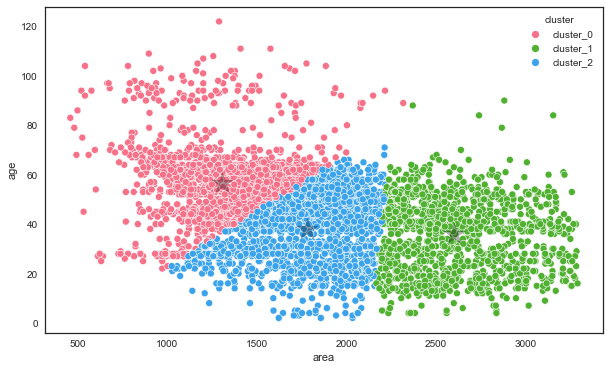

In [65]:
X = train_OC[['area', 'age']]

train_OC, X_scaled, scaler, kmeans = create_clusters(train_OC, X, 3)


centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

create_scatter('area', 'age', train_OC, kmeans, X_scaled, scaler)

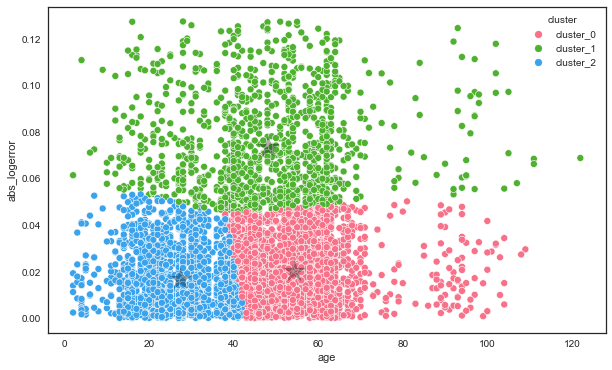

In [66]:
X = train_OC[['age', 'abs_logerror']]

train_OC, X_scaled, scaler, kmeans = create_clusters(train_OC, X, 3)


centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

create_scatter('age', 'abs_logerror', train_OC, kmeans, X_scaled, scaler)

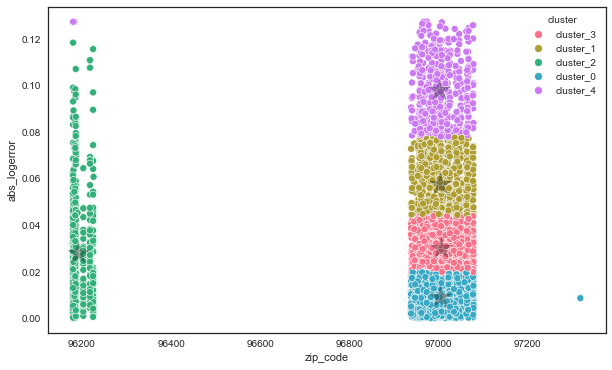

In [67]:
X = train_OC[['zip_code', 'abs_logerror']]

train_OC, X_scaled, scaler, kmeans = create_clusters(train_OC, X, 5)


centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

create_scatter('zip_code', 'abs_logerror', train_OC, kmeans, X_scaled, scaler)

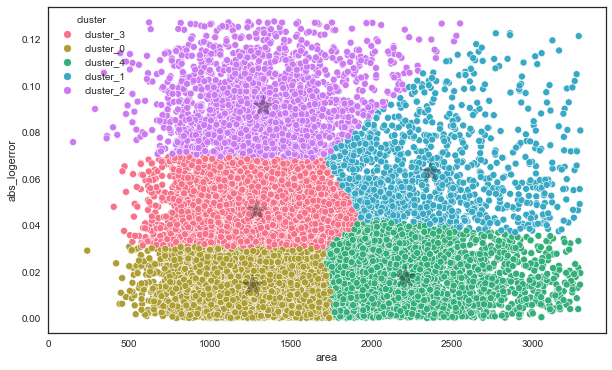

In [68]:
X = train_LA[['area', 'abs_logerror']]

train_LA, X_scaled, scaler, kmeans = create_clusters(train_LA, X, 5)


centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

create_scatter('area', 'abs_logerror', train_LA, kmeans, X_scaled, scaler)

In [69]:
train_scaled.columns

Index(['propertylandusetypeid', 'bathrooms', 'bedrooms', 'area', 'county',
       'latitude', 'longitude', 'lot_size', 'census_tract', 'region_id_city',
       'region_id_county', 'zip_code', 'room_count', 'unit_count',
       'year_built', 'tax_value', 'total_tax', 'assessment_year', 'land_value',
       'tax_amount', 'transaction_date', 'logerror', 'property_desc', 'LA',
       'Orange', 'Ventura', 'age', 'age_bin', 'tax_rate', 'acres', 'acres_bin',
       'sqft_bin', 'structure_dollar_per_sqft', 'structure_dollar_sqft_bin',
       'land_dollar_per_sqft', 'lot_dollar_sqft_bin', 'bath_bed_ratio', 'cola',
       'logerror_bins', 'bed_and_bath', 'tax_value_binned',
       'tax_value_encoded', 'pw_build', 'pw_build_encoded', 'abs_logerror'],
      dtype='object')

In [76]:
train_scaled.isna().sum()

propertylandusetypeid        0
bathrooms                    0
bedrooms                     0
area                         0
county                       0
latitude                     0
longitude                    0
lot_size                     0
census_tract                 0
region_id_city               0
region_id_county             0
zip_code                     0
room_count                   0
unit_count                   0
year_built                   0
tax_value                    0
total_tax                    0
assessment_year              0
land_value                   0
tax_amount                   0
transaction_date             0
logerror                     0
property_desc                0
LA                           0
Orange                       0
Ventura                      0
age                          0
age_bin                      0
tax_rate                     0
acres                        0
acres_bin                    0
sqft_bin                     0
structur

In [78]:
features = train_scaled[['lot_size', 'land_value', 'total_tax', 'tax_value', 'logerror']]

kmeans = KMeans(n_clusters = 4).fit(features[['lot_size', 'land_value', 'total_tax', 'tax_value']])

clusters = pd.DataFrame(kmeans.labels_) #This is where the label output of the KMeans we just ran lives. Make it a dataframe so we can concatenate back to the original data
c_df1 = pd.concat((features, clusters), axis = 1)
c_df1 = c_df1.rename({0:'clusters'}, axis = 1)

c_df1['Constant'] = "X" #This is just to add something constant for the strip/swarm plots' X axis. Can be anything you want it to be.

sns.stripplot(data = c_df1,
              x = 'Constant',
              y = 'logerror',
              hue = 'clusters',
              palette = 'husl',
              jitter = True)



AttributeError: 'KMeans' object has no attribute 'clusters_'

In [77]:
c_df1.isna().sum()

lot_size      15447
land_value    15447
total_tax     15447
tax_value     15447
logerror      15447
clusters      15447
Constant          0
dtype: int64

In [71]:
#c_df2

features = train_scaled[['area', 'age', 'year_built','logerror']]

kmeans = KMeans(n_clusters = 3).fit(features[['area', 'age', 'year_built']])

clusters = pd.DataFrame(kmeans.labels_) #This is where the label output of the KMeans we just ran lives. Make it a dataframe so we can concatenate back to the original data
c_df2 = pd.concat((features, clusters),axis = 1)
c_df2 = c_df1.rename({0:'clusters'}, axis = 1)

c_df2['Constant'] = "X" #This is just to add something constant for the strip/swarm plots' X axis. Can be anything you want it to be.

sns.stripplot(data = c_df2,
              x = 'Constant',
              y = 'logerror',
              hue = 'clusters',
              palette = 'husl',
              jitter = True)


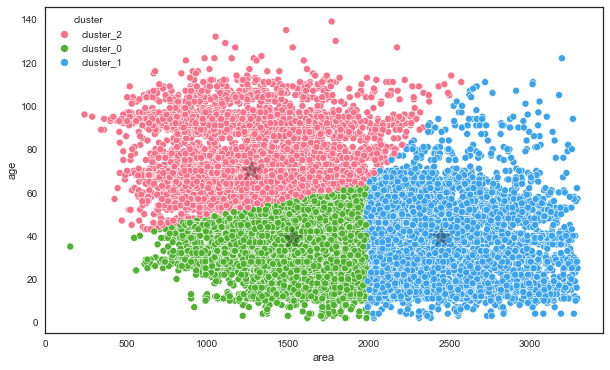

In [72]:
X = train[['area', 'age']]

train, X_scaled, scaler, kmeans = create_clusters(train, X, 3)


centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns = X_scaled.columns)

create_strip('area', 'age', train, kmeans, X_scaled, scaler)



f, axes = plt.subplots(4, 5, figsize=(20, 25), sharex=False) #create a 4x5 grid of empty figures where we will plot our feature plots. We will have a couple empty ones.
f.subplots_adjust(hspace=0.2, wspace=0.7) #Scooch em apart, give em some room
#In this for loop, I step through every column that I want to plot. This is a 4x5 grid, so I split this up by rows of 5 in the else if statements
for i in range(0,len(list(train))-2): #minus two because I don't want to plot labels or constant
    col = labeledColleges.columns[i]
    if i < 5:
        ax = sns.stripplot(x=labeledColleges['Constant'],y=labeledColleges[col].values,hue=labeledColleges['labels'],jitter=True,ax=axes[0,(i)])
        ax.set_title(col)
    elif i >= 5 and i<10:
        ax = sns.stripplot(x=labeledColleges['Constant'],y=labeledColleges[col].values,hue=labeledColleges['labels'],jitter=True,ax=axes[1,(i-5)]) #so if i=6 it is row 1 column 1
        ax.set_title(col)
    elif i >= 10 and i<15:
        ax = sns.stripplot(x=labeledColleges['Constant'],y=labeledColleges[col].values,hue=labeledColleges['labels'],jitter=True,ax=axes[2,(i-10)])
        ax.set_title(col)
    elif i >= 15:
        ax = sns.stripplot(x=labeledColleges['Constant'],y=labeledColleges[col].values,hue=labeledColleges['labels'],jitter=True,ax=axes[3,(i-15)])
        ax.set_title(col)



### Clustering w/ PCA

#initialize PCA models

#PCA with one principal component
pca_1d = PCA(n_components = 1)

#PCA with two principal components
pca_2d = PCA(n_components = 2)

#PCA with three principal components
pca_3d = PCA(n_components = 3)

#create X variable
X = train_scaled[[]]

#create kmeans variable
kmeans = KMeans(n_clusters = 3, random_state = 123)

#fit
kmeans.fit(X)

#make predicttions
kmeans.predict(X)

#make predictions and assign to new column
train_scaled['cluster'] = kmeans.predict(X)

In [73]:
train.logerror.mean()

0.004163035221261488

In [74]:
train.zip_code.head()

48107    96473
67544    97020
53781    96106
60586    97319
31011    96505
Name: zip_code, dtype: int64

#initialize PCA models

#PCA with one principal component
pca_1d = PCA(n_components = 1)

#PCA with two principal components
pca_2d = PCA(n_components = 2)

#PCA with three principal components
pca_3d = PCA(n_components = 3)


#create X variable
X = train_scaled[['longitude', 'latitude', 'age']]

#create kmeans variable
kmeans = KMeans(n_clusters = 3, random_state = 123)

#fit
kmeans.fit(X)

#make predicttions
kmeans.predict(X)

#make predictions and assign to new column
train['cluster'] = kmeans.predict(X)

#add cluster column to X
X['cluster'] = kmeans.predict(X)

#This DataFrame holds that single principal component mentioned above
PCs_1d = pd.DataFrame(pca_1d.fit_transform(X.drop(["cluster"], axis = 1)))

#This DataFrame contains the two principal components that will be used
#for the 2-D visualization mentioned above
PCs_2d = pd.DataFrame(pca_2d.fit_transform(X.drop(["cluster"], axis = 1)))

#And this DataFrame contains three principal components that will aid us
#in visualizing our clusters in 3-D
PCs_3d = pd.DataFrame(pca_3d.fit_transform(X.drop(["cluster"], axis = 1)))

#rename column for the principle component of the component created for 1D visualization by PCA

PCs_1d.columns = ["PC1_1d"]

#"PC1_2d" means: 'The first principal component of the components created for 2D visualization, by PCA.'
#And "PC2_2d" means: 'The second principal component of the components created for 2-D visualization, by PCA.'
PCs_2d.columns = ["PC1_2d", "PC2_2d"]

#rename columns for each of the principle components created for 3D visualization
PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]


#concatenate these newly created dfs to X so that they can be used by X as columns
X = pd.concat([X, PCs_1d, PCs_2d, PCs_3d], axis = 1, join = 'inner')

#create dummy column for 1D visualization
X['dummy'] = 0

#create sub-dfs for X to plot values contained within each of these dfs

cluster0 = X[X["cluster"] == 0]
cluster1 = X[X["cluster"] == 1]
cluster2 = X[X["cluster"] == 2]

#req'd to display plotly plots properly
init_notebook_mode(connected = True)

#Instructions for building the 1-D plot

#trace1 is for 'Cluster 0'
trace1 = go.Scatter(
                    x = cluster0["PC1_1d"],
                    y = cluster0["dummy"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)

#trace2 is for 'Cluster 1'
trace2 = go.Scatter(
                    x = cluster1["PC1_1d"],
                    y = cluster1["dummy"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)

#trace3 is for 'Cluster 2'
trace3 = go.Scatter(
                    x = cluster2["PC1_1d"],
                    y = cluster2["dummy"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)

data = [trace1, trace2, trace3]

title = "Visualizing Clusters in One Dimension Using PCA"

layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 5,zeroline= False),
              yaxis= dict(title= '',ticklen= 5,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

#req'd to display plotly plots properly
init_notebook_mode(connected = True)

#Instructions for building the 2-D plot

#trace1 is for 'Cluster 0'
trace1 = go.Scatter(
                    x = cluster0["PC1_2d"],
                    y = cluster0["PC2_2d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)

#trace2 is for 'Cluster 1'
trace2 = go.Scatter(
                    x = cluster1["PC1_2d"],
                    y = cluster1["PC2_2d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)

#trace3 is for 'Cluster 2'
trace3 = go.Scatter(
                    x = cluster2["PC1_2d"],
                    y = cluster2["PC2_2d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)

data = [trace1, trace2, trace3]

title = "Visualizing Clusters in Two Dimensions Using PCA"

layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 5,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)


#Instructions for building the 3-D plot

#trace1 is for 'Cluster 0'
trace1 = go.Scatter3d(
                    x = cluster0["PC1_3d"],
                    y = cluster0["PC2_3d"],
                    z = cluster0["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 0",
                    marker = dict(color = 'rgba(255, 128, 255, 0.8)'),
                    text = None)

#trace2 is for 'Cluster 1'
trace2 = go.Scatter3d(
                    x = cluster1["PC1_3d"],
                    y = cluster1["PC2_3d"],
                    z = cluster1["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 1",
                    marker = dict(color = 'rgba(255, 128, 2, 0.8)'),
                    text = None)

#trace3 is for 'Cluster 2'
trace3 = go.Scatter3d(
                    x = cluster2["PC1_3d"],
                    y = cluster2["PC2_3d"],
                    z = cluster2["PC3_3d"],
                    mode = "markers",
                    name = "Cluster 2",
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = None)

data = [trace1, trace2, trace3]

title = "Visualizing Clusters in Three Dimensions Using PCA"

layout = dict(title = title,
              xaxis= dict(title= 'PC1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'PC2',ticklen= 5,zeroline= False)
             )

fig = dict(data = data, layout = layout)

iplot(fig)

In [80]:
#get baseline, baseline is mean of dependent variable yhat_baseline == baseline

baseline = train.logerror.mean()

print(f' Baseline is: {baseline:.5f}')

 Baseline is: 0.00416


In [83]:
#create X's on scaled data
X_train = train_scaled[['area', 'age']]
X_validate = validate_scaled[['area', 'age']]
X_test = test_scaled[['area', 'age']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].mean()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = round(y_validate['logerror'].mean(), 2)

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Multilinear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Multilinear Regression Model
Training/In-Sample:  0.04384 
Validation/Out-of-Sample:  0.04381


In [84]:
#create X's on scaled data
X_train = train_scaled[['area']]
X_validate = validate_scaled[['area']]
X_test = test_scaled[['area']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].mean()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = round(y_validate['logerror'].mean(), 2)

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Multilinear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Multilinear Regression Model
Training/In-Sample:  0.04384 
Validation/Out-of-Sample:  0.04381


In [85]:
#create X's on scaled data
X_train = train_scaled[['longitude', 'latitude']]
X_validate = validate_scaled[['longitude', 'latitude']]
X_test = test_scaled[['longitude', 'latitude']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].mean()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = round(y_validate['logerror'].mean(), 2)

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Multilinear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Multilinear Regression Model
Training/In-Sample:  0.04396 
Validation/Out-of-Sample:  0.04397


In [86]:
#create X's on scaled data
X_train = train_scaled[['latitude', 'zip_code']]
X_validate = validate_scaled[['latitude', 'zip_code']]
X_test = test_scaled[['latitude', 'zip_code']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].mean()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = round(y_validate['logerror'].mean(), 2)

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Multilinear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Multilinear Regression Model
Training/In-Sample:  0.04397 
Validation/Out-of-Sample:  0.04397


In [91]:
#create X's on scaled data
X_train = train_scaled[['bedrooms', 'age']]
X_validate = validate_scaled[['bedrooms', 'age']]
X_test = test_scaled[['bedrooms', 'age']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].mean()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = round(y_validate['logerror'].mean(), 2)

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)

#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print( "RMSE for Multilinear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

SyntaxError: f-string: unmatched '[' (3827208458.py, line 52)

In [93]:
#create X's on scaled data
X_train = train_scaled[['bedrooms', 'age']]
X_validate = validate_scaled[['bedrooms', 'age']]
X_test = test_scaled[['bedrooms', 'age']]

#create y's on unscaled data
y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]

#create model
lr = LinearRegression(normalize = True)

lr.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr.predict(X_validate), 2)

#add baseline to train df
y_train['baseline'] = y_train['logerror'].median()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_train['residual_baseline'] = y_train.baseline - y_train.logerror

y_train['predictions_yhat'] = np.round(y_train_pred, 2)


#add baseline to validate df
y_validate['baseline'] = y_validate['logerror'].median()

#add residual baseline to train df
#residual_baseline = baseline - y_train.target
y_validate['residual_baseline'] = y_validate.baseline - y_validate.logerror

#add predictions to df
y_validate['predictions_yhat'] = np.round(y_validate_pred, 2)

#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evaluate RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print( "RMSE for Multilinear Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Multilinear Regression Model
Training/In-Sample:  0.04397 
Validation/Out-of-Sample:  0.04401


In [96]:
np.sqrt(train['logerror'].median() )

0.06666125848039474

In [88]:
#create X's on scaled data

X_train = train_scaled[['area', 'age']]
X_validate = validate_scaled[['area', 'age']]
X_test = test_scaled[['area', 'age']]

# create y's on unscaled data

y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]


#create model
lars = LassoLars(alpha = 1)

lars.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lars.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lars.predict(X_validate), 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Lasso + Lars Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Lasso + Lars Model
Training/In-Sample:  0.04407 
Validation/Out-of-Sample:  0.04409


In [ ]:
#create X's on scaled data

X_train = train_scaled[['zip_code']]
X_validate = validate_scaled[['area', 'age']]
X_test = test_scaled[['area', 'age']]

# create y's on unscaled data

y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]


#create model
lars = LassoLars(alpha = 1)

lars.fit(X_train, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lars.predict(X_train), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lars.predict(X_validate), 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Lasso + Lars Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

In [89]:
#create X's on scaled data

X_train = train_scaled[['area', 'age']]
X_validate = validate_scaled[['area', 'age']]
X_test = test_scaled[['area', 'age']]

# create y's on unscaled data

y_train = train[['logerror']]
y_validate = validate[['logerror']]
y_test = test[['logerror']]


#create converter
pf = PolynomialFeatures(degree = 3)


#fit and transform  on x_scaled
X_train_degree3 = pf.fit_transform(X_train)


#transform X_validate & X_test
X_validate_degree3 = pf.transform(X_validate)

X_test_degree3 = pf.transform(X_test)


#make lr model

lr_p = LinearRegression(normalize = True)

#fit to converted train
lr_p.fit(X_train_degree3, y_train)

#make predictions on train (yhat)
y_train_pred = np.round(lr_p.predict(X_train_degree3), 2)

#make predictions on validate(yhat)
y_validate_pred = np.round(lr_p.predict(X_validate_degree3), 2)


#evaluate RMSE on train 

RMSE_train = np.sqrt(mean_squared_error(y_train[['logerror']], y_train_pred))

#evalue RMSE on validate

RMSE_validate = np.sqrt(mean_squared_error(y_validate[['logerror']], y_validate_pred))

#print results
print("RMSE for Polynomial Regression Model\nTraining/In-Sample: ", f'{RMSE_train:.5f}', 
      "\nValidation/Out-of-Sample: ", f'{RMSE_validate:.5f}')

RMSE for Polynomial Regression Model
Training/In-Sample:  0.04383 
Validation/Out-of-Sample:  0.04376


In [101]:
def create_baseline(y_train, y_validate, target):
    '''
    Take in a y_train and y_validate dataframe and target variable(logerror). 
    Calculate the mean and median of the target variable and print the result side by side comparsion
    Select the one has lowest RMSE
    And then append into a dataframe called metric_df
    '''
    #tax_value mean
    logerror_pred_mean = y_train[target].mean()
    y_train['logerror_pred_mean'] = logerror_pred_mean
    y_validate['logerror_pred_mean'] = logerror_pred_mean

    #tax_value_median
    logerror_pred_median = y_train[target].median()
    y_train['logerror_pred_median'] = logerror_pred_median
    y_validate['logerror_pred_median'] = logerror_pred_median


    #RMSE of logerror_pred_mean
    rmse_mean_train = np.sqrt(mean_squared_error(y_train[target], y_train.logerror_pred_mean))
    rmse_mean_validate = np.sqrt(mean_squared_error(y_validate[target], y_validate.logerror_pred_mean))


    #RMSE of logerror _pred_median
    rmse_median_train = np.sqrt(mean_squared_error(y_train[target], y_train.logerror_pred_median))
    rmse_median_validate = np.sqrt(mean_squared_error(y_validate[target], y_validate.logerror_pred_median))

    #R2 score for the baseline
    r2_baseline = r2_score(y_validate[target], y_validate.logerror_pred_mean)

    #Append rmse validate and r2 score into a dataframe
    metric_df = pd.DataFrame(data=[{
    'model': 'Mean Baseline',
    'rmse_train': rmse_mean_train,
    'rmse_validate': rmse_mean_validate,
    'r^2_value': r2_baseline}])

    return  metric_df, rmse_mean_train, rmse_mean_validate, rmse_median_train, rmse_median_validate, r2_baseline


In [102]:
#Create baseline
metric_df, rmse_mean_train, rmse_mean_validate, rmse_median_train, rmse_median_validate, r2_baseline = create_baseline(y_train, y_validate, 'logerror')

In [103]:
metric_df

,model,rmse_train,rmse_validate,r^2_value
0,Mean Baseline,0.043871,0.043878,-0.000005


In [104]:
print(rmse_mean_train)
print(rmse_median_train)

0.0438711976494843
0.043872095562484836


In [ ]:
#blvd

#clustering lat, long, tax_value

#create X variable
X = train_scaled[['latitude', 'longitude', 'tax_value', 'logerror']]

#create kmeans variable
kmeans = KMeans(n_clusters = 3, random_state = 123)

#fit
kmeans.fit(X[['latitude', 'longitude', 'tax_value']])

#make predicttions
kmeans.predict(X[['latitude', 'longitude', 'tax_value']])

#make predictions and assign to new column
train_scaled['area_val_cluster'] = kmeans.predict(X[['latitude', 'longitude', 'tax_value']])

#make centroids df
centroids = pd.DataFrame(kmeans.cluster_centers_, columns = X.columns[['latitude', 'longitude', 'tax_value']])

train_scaled.groupby('area_val_cluster')['latitude', 'longitude', 'tax_value'].mean()

In [ ]:
#define alpha
α = 0.05

#assign clusters to variables
area_val_cluster_0 = train_scaled[train_scaled.area_val_cluster == 'cluster_0'].logerror
area_val_cluster_1 = train_scaled[train_scaled.area_val_cluster == 'cluster_1'].logerror
area_val_cluster_2 = train_scaled[train_scaled.area_val_cluster == 'cluster_2'].logerror

#perform test
f, p = f_oneway(area_val_cluster_0, area_val_cluster_1, area_val_cluster_2)

#evaluate coefficient and p-value
print(f'F - Statistic: {f:.3f}\nP-value: {p:.3f}')

#evaluate if p < α
if p < α:
    print('Reject the null hypothesis.')
else:
    print('Fail to reject the null hypothesis.')